# DS Unit 01 Build
## DSPT5 Ilmo Koo


Dataset: Stack Overflow Developer Survey Results 2019

In [2]:
# imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
# Plotly imports
import plotly
import plotly.graph_objs as go
import plotly.express as px

In [4]:
df = pd.read_pickle('./survey_data_2019.pkl')
df_sch = pd.read_csv('./survey_results_schema.csv')

In [5]:
df.head()

,Respondent,MainBranch,Hobbyist,OpenSourcer,OpenSource,Employment,Country,Student,EdLevel,UndergradMajor,...,WelcomeChange,SONewContent,Age,Gender,Trans,Sexuality,Ethnicity,Dependents,SurveyLength,SurveyEase
0,1,I am a student who is learning to code,Yes,Never,The quality of OSS and closed source software ...,"Not employed, and not looking for work",United Kingdom,No,Primary/elementary school,NaN,...,Just as welcome now as I felt last year,Tech articles written by other developers;Indu...,14.0,Man,No,Straight / Heterosexual,NaN,No,Appropriate in length,Neither easy nor difficult
1,2,I am a student who is learning to code,No,Less than once per year,The quality of OSS and closed source software ...,"Not employed, but looking for work",Bosnia and Herzegovina,"Yes, full-time","Secondary school (e.g. American high school, G...",NaN,...,Just as welcome now as I felt last year,Tech articles written by other developers;Indu...,19.0,Man,No,Straight / Heterosexual,NaN,No,Appropriate in length,Neither easy nor difficult
2,3,"I am not primarily a developer, but I write co...",Yes,Never,The quality of OSS and closed source software ...,Employed full-time,Thailand,No,"Bachelor’s degree (BA, BS, B.Eng., etc.)",Web development or web design,...,Just as welcome now as I felt last year,Tech meetups or events in your area;Courses on...,28.0,Man,No,Straight / Heterosexual,NaN,Yes,Appropriate in length,Neither easy nor difficult
3,4,I am a developer by profession,No,Never,The quality of OSS and closed source software ...,Employed full-time,United States,No,"Bachelor’s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,Tech articles written by other developers;Indu...,22.0,Man,No,Straight / Heterosexual,White or of European descent,No,Appropriate in length,Easy
4,5,I am a developer by profession,Yes,Once a month or more often,"OSS is, on average, of HIGHER quality than pro...",Employed full-time,Ukraine,No,"Bachelor’s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,Tech meetups or events in your area;Courses on...,30.0,Man,No,Straight / Heterosexual,White or of European descent;Multiracial,No,Appropriate in length,Easy


In [6]:
df.iloc[0]

Respondent                                                      1
MainBranch                 I am a student who is learning to code
Hobbyist                                                      Yes
OpenSourcer                                                 Never
OpenSource      The quality of OSS and closed source software ...
                                      ...                        
Sexuality                                 Straight / Heterosexual
Ethnicity                                                     NaN
Dependents                                                     No
SurveyLength                                Appropriate in length
SurveyEase                             Neither easy nor difficult
Name: 0, Length: 85, dtype: object

In [7]:
# let's see what each column means
pd.set_option('display.max_rows', df_sch.shape[0]+1)
print(df_sch)

Column                                       QuestionText
0               Respondent  Randomized respondent ID number (not in order ...
1               MainBranch  Which of the following options best describes ...
2                 Hobbyist                            Do you code as a hobby?
3              OpenSourcer        How often do you contribute to open source?
4               OpenSource  How do you feel about the quality of open sour...
5               Employment  Which of the following best describes your cur...
6                  Country          In which country do you currently reside?
7                  Student  Are you currently enrolled in a formal, degree...
8                  EdLevel  Which of the following best describes the high...
9           UndergradMajor  What was your main or most important field of ...
10                EduOther  Which of the following types of non-degree edu...
11                 OrgSize  Approximately how many people are employed by ...
12    

# choice and concentration
There are 85 columns and it is necessary to focus a few of them
I might add and analyze more data, but for now let's pick maybe a couple
Let's keep it simple (LEAN)

## Prior to EDA
There are a few assumptions/stoires that I want to validate from the data. 
I am not sure which to pick and analyze but let's brainstrom them first.

1. Are bootcamp graduates doing well in the field?
2. B.S or higher of C.S. degree really matter in terms of salary?
3. 

# 

In [8]:
df.shape

(88883, 85)

In [9]:
df_sch.shape

(85, 2)

In [10]:
df.describe()

,Respondent,CompTotal,ConvertedComp,WorkWeekHrs,CodeRevHrs,Age
count,88883.000000,5.594500e+04,5.582300e+04,64503.000000,49790.000000,79210.000000
mean,44442.000000,5.519014e+11,1.271107e+05,42.127197,5.084308,30.336699
std,25658.456325,7.331926e+13,2.841523e+05,37.287610,5.513931,9.178390
min,1.000000,0.000000e+00,0.000000e+00,1.000000,0.000000,1.000000
25%,22221.500000,2.000000e+04,2.577750e+04,40.000000,2.000000,24.000000
50%,44442.000000,6.200000e+04,5.728700e+04,40.000000,4.000000,29.000000
75%,66662.500000,1.200000e+05,1.000000e+05,44.750000,6.000000,35.000000
max,88883.000000,1.000000e+16,2.000000e+06,4850.000000,99.000000,99.000000


In [11]:
df.dtypes

Respondent                  int64
MainBranch                 object
Hobbyist                   object
OpenSourcer                object
OpenSource                 object
Employment                 object
Country                    object
Student                    object
EdLevel                    object
UndergradMajor             object
EduOther                   object
OrgSize                    object
DevType                    object
YearsCode                  object
Age1stCode                 object
YearsCodePro               object
CareerSat                  object
JobSat                     object
MgrIdiot                   object
MgrMoney                   object
MgrWant                    object
JobSeek                    object
LastHireDate               object
LastInt                    object
FizzBuzz                   object
JobFactors                 object
ResumeUpdate               object
CurrencySymbol             object
CurrencyDesc               object
CompTotal     

In [12]:
df.select_dtypes(include=np.number).columns.tolist()


['Respondent',
 'CompTotal',
 'ConvertedComp',
 'WorkWeekHrs',
 'CodeRevHrs',
 'Age']

In [13]:
df.isna().sum()

Respondent                    0
MainBranch                  552
Hobbyist                      0
OpenSourcer                   0
OpenSource                 2041
Employment                 1702
Country                     132
Student                    1869
EdLevel                    2493
UndergradMajor            13269
EduOther                   4623
OrgSize                   17092
DevType                    7548
YearsCode                   945
Age1stCode                 1249
YearsCodePro              14552
CareerSat                 16036
JobSat                    17895
MgrIdiot                  27724
MgrMoney                  27726
MgrWant                   27651
JobSeek                    8328
LastHireDate               9029
LastInt                   21728
FizzBuzz                  17539
JobFactors                 9512
ResumeUpdate              11006
CurrencySymbol            17491
CurrencyDesc              17491
CompTotal                 32938
CompFreq                  25615
Converte

In [14]:
# let's see if I can filter out non-numeric columns from df
df_obj = df.select_dtypes(['object'])
print(df_obj.shape)
print(df_obj.dtypes)

(88883, 79)
MainBranch                object
Hobbyist                  object
OpenSourcer               object
OpenSource                object
Employment                object
Country                   object
Student                   object
EdLevel                   object
UndergradMajor            object
EduOther                  object
OrgSize                   object
DevType                   object
YearsCode                 object
Age1stCode                object
YearsCodePro              object
CareerSat                 object
JobSat                    object
MgrIdiot                  object
MgrMoney                  object
MgrWant                   object
JobSeek                   object
LastHireDate              object
LastInt                   object
FizzBuzz                  object
JobFactors                object
ResumeUpdate              object
CurrencySymbol            object
CurrencyDesc              object
CompFreq                  object
WorkPlan                  objec

In [31]:
# let's filter out numeric columns
df_num = df.select_dtypes(np.number)
print(df_num.shape)
print(df_num.dtypes)

(88883, 6)
Respondent         int64
CompTotal        float64
ConvertedComp    float64
WorkWeekHrs      float64
CodeRevHrs       float64
Age              float64
dtype: object


In [32]:
df_num_corr = df_num.corr()
df_num_corr

,Respondent,CompTotal,ConvertedComp,WorkWeekHrs,CodeRevHrs,Age
Respondent,1.000000,-0.003357,0.002930,-0.004589,-0.005240,-0.001829
CompTotal,-0.003357,1.000000,0.039725,0.003074,0.061090,0.016500
ConvertedComp,0.002930,0.039725,1.000000,0.013908,-0.021261,0.108268
WorkWeekHrs,-0.004589,0.003074,0.013908,1.000000,0.021092,0.019976
CodeRevHrs,-0.005240,0.061090,-0.021261,0.021092,1.000000,-0.022486
Age,-0.001829,0.016500,0.108268,0.019976,-0.022486,1.000000


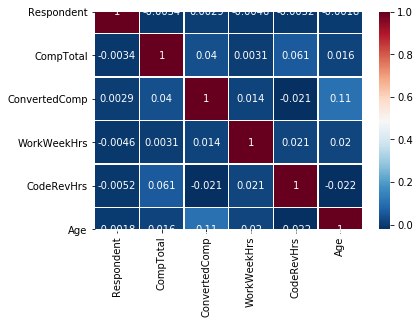

In [29]:
sns.heatmap(df_num_corr,
cmap='RdBu_r',
annot=True,
linewidth=0.5)

In [16]:
pd.crosstab(df['EdLevel'], df['EduOther'])

EduOther,Completed an industry certification program (e.g. MCPD),Completed an industry certification program (e.g. MCPD);Contributed to open source software,Completed an industry certification program (e.g. MCPD);Participated in a hackathon,Completed an industry certification program (e.g. MCPD);Participated in a hackathon;Contributed to open source software,"Completed an industry certification program (e.g. MCPD);Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder)","Completed an industry certification program (e.g. MCPD);Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Contributed to open source software","Completed an industry certification program (e.g. MCPD);Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon","Completed an industry certification program (e.g. MCPD);Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon;Contributed to open source software",Completed an industry certification program (e.g. MCPD);Received on-the-job training in software development,Completed an industry certification program (e.g. MCPD);Received on-the-job training in software development;Contributed to open source software,...,"Taken an online course in programming or software development (e.g. a MOOC);Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon","Taken an online course in programming or software development (e.g. a MOOC);Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon;Contributed to open source software","Taught yourself a new language, framework, or tool without taking a formal course","Taught yourself a new language, framework, or tool without taking a formal course;Contributed to open source software","Taught yourself a new language, framework, or tool without taking a formal course;Participated in a hackathon","Taught yourself a new language, framework, or tool without taking a formal course;Participated in a hackathon;Contributed to open source software","Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder)","Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Contributed to open source software","Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon","Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon;Contributed to open source software"
EdLevel,,,,,,,,,,,,,,,,,,,,,
Associate degree,11,1,0,0,0,0,0,0,3,1,...,11,17,212,123,16,22,21,21,10,9
"Bachelor’s degree (BA, BS, B.Eng., etc.)",107,7,9,6,7,2,4,0,24,5,...,332,521,2607,1313,358,497,373,304,234,353
I never completed any formal education,6,1,0,0,0,0,0,0,1,0,...,1,3,44,34,0,10,4,5,1,2
"Master’s degree (MA, MS, M.Eng., MBA, etc.)",66,9,3,1,5,4,0,1,17,4,...,143,246,1337,846,134,246,156,197,56,181
"Other doctoral degree (Ph.D, Ed.D., etc.)",5,1,0,1,0,0,0,0,0,0,...,6,31,219,221,11,59,15,41,4,25
Primary/elementary school,3,0,0,0,0,0,0,0,0,0,...,8,15,198,96,6,17,26,18,3,11
"Professional degree (JD, MD, etc.)",3,0,0,0,1,0,1,0,1,0,...,4,4,75,38,8,7,10,6,1,6
"Secondary school (e.g. American high school, German Realschule or Gymnasium, etc.)",19,1,2,0,0,0,0,0,5,1,...,88,140,990,527,75,141,147,161,50,102
Some college/university study without earning a degr

In [17]:
df['EdLevel'].isna().sum()

2493

In [18]:
df['EdLevel'].value_counts()

Bachelor’s degree (BA, BS, B.Eng., etc.)                                              39134
Master’s degree (MA, MS, M.Eng., MBA, etc.)                                           19569
Some college/university study without earning a degree                                10502
Secondary school (e.g. American high school, German Realschule or Gymnasium, etc.)     8642
Associate degree                                                                       2938
Other doctoral degree (Ph.D, Ed.D., etc.)                                              2432
Primary/elementary school                                                              1422
Professional degree (JD, MD, etc.)                                                     1198
I never completed any formal education                                                  553
Name: EdLevel, dtype: int64

In [19]:
# let's see education level
data = go.Histogram(
    y=df['EdLevel'],
    histnorm='percent'
    )
fig = go.Figure(data=[data])
fig.update_layout(
    title_text='Education Level', # title of plot
    xaxis_title_text='Counts', # xaxis label
    yaxis_title_text='Ed Level', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.update_yaxes(automargin=True)
fig.show()

In [45]:
fig = px.box(df, x="EdLevel", y='ConvertedComp', range_y=[0, 2*10**5])
fig.show()

In [107]:
# let's define df for only United States Country respondent
df_us = df[df['Country'] == 'United States']
df_us['Country'].head()

3     United States
12    United States
21    United States
22    United States
25    United States
Name: Country, dtype: object

In [60]:
# I need to show exact median values for B.S. degree vs I never completed formal education
df_us.groupby(['EdLevel'])['ConvertedComp'].median()

EdLevel
Associate degree                                                                       90000.0
Bachelor’s degree (BA, BS, B.Eng., etc.)                                              110000.0
I never completed any formal education                                                123500.0
Master’s degree (MA, MS, M.Eng., MBA, etc.)                                           125000.0
Other doctoral degree (Ph.D, Ed.D., etc.)                                             140000.0
Primary/elementary school                                                             120000.0
Professional degree (JD, MD, etc.)                                                    106500.0
Secondary school (e.g. American high school, German Realschule or Gymnasium, etc.)     95000.0
Some college/university study without earning a degree                                107000.0
Name: ConvertedComp, dtype: float64

In [108]:
df_us['YearsCodePro'] = df_us['YearsCodePro'].apply(lambda x: 0.5 if x == 'Less than 1 year' else (50 if x == 'More than 50 years' else x))

In [109]:
df_us.head()

,Respondent,MainBranch,Hobbyist,OpenSourcer,OpenSource,Employment,Country,Student,EdLevel,UndergradMajor,...,WelcomeChange,SONewContent,Age,Gender,Trans,Sexuality,Ethnicity,Dependents,SurveyLength,SurveyEase
3,4,I am a developer by profession,No,Never,The quality of OSS and closed source software ...,Employed full-time,United States,No,"Bachelor’s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,Tech articles written by other developers;Indu...,22.0,Man,No,Straight / Heterosexual,White or of European descent,No,Appropriate in length,Easy
12,13,I am a developer by profession,Yes,Less than once a month but more than once per ...,"OSS is, on average, of HIGHER quality than pro...",Employed full-time,United States,No,"Master’s degree (MA, MS, M.Eng., MBA, etc.)","Computer science, computer engineering, or sof...",...,Somewhat more welcome now than last year,Tech articles written by other developers;Cour...,28.0,Man,No,Straight / Heterosexual,White or of European descent,Yes,Appropriate in length,Easy
21,22,I am a developer by profession,Yes,Less than once per year,"OSS is, on average, of HIGHER quality than pro...",Employed full-time,United States,No,Some college/university study without earning ...,NaN,...,Just as welcome now as I felt last year,Tech articles written by other developers;Indu...,47.0,Man,No,Straight / Heterosexual,White or of European descent,Yes,Appropriate in length,Easy
22,23,I am a developer by profession,Yes,Less than once per year,The quality of OSS and closed source software ...,Employed full-time,United States,No,"Bachelor’s degree (BA, BS, B.Eng., etc.)","Information systems, information technology, o...",...,Just as welcome now as I felt last year,Tech articles written by other developers;Tech...,22.0,Man,No,Straight / Heterosexual,Black or of African descent,No,Appropriate in length,Easy
25,26,I am a developer by profession,Yes,Less than once per year,The quality of OSS and closed source software ...,Employed full-time,United States,No,Some college/university study without earning ...,"Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,NaN,34.0,Man,No,Gay or Lesbian,NaN,No,Appropriate in length,Easy


In [113]:
df_us[df_us['YearsCodePro'] == 0.5]

,Respondent,MainBranch,Hobbyist,OpenSourcer,OpenSource,Employment,Country,Student,EdLevel,UndergradMajor,...,WelcomeChange,SONewContent,Age,Gender,Trans,Sexuality,Ethnicity,Dependents,SurveyLength,SurveyEase
3,4,I am a developer by profession,No,Never,The quality of OSS and closed source software ...,Employed full-time,United States,No,"Bachelor’s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,Tech articles written by other developers;Indu...,22.0,Man,No,Straight / Heterosexual,White or of European descent,No,Appropriate in length,Easy
306,308,I am a developer by profession,Yes,Never,"OSS is, on average, of HIGHER quality than pro...",Employed full-time,United States,No,"Master’s degree (MA, MS, M.Eng., MBA, etc.)","Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,NaN,36.0,Woman,No,Straight / Heterosexual,White or of European descent,No,Appropriate in length,Easy
316,318,I am a developer by profession,Yes,Less than once per year,The quality of OSS and closed source software ...,Employed full-time,United States,"Yes, full-time","Bachelor’s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,NaN,21.0,Man,No,Bisexual;Straight / Heterosexual,South Asian,No,Too long,Easy
378,380,I am a developer by profession,No,Never,"OSS is, on average, of HIGHER quality than pro...",Employed part-time,United States,No,"Secondary school (e.g. American high school, G...",NaN,...,Just as welcome now as I felt last year,NaN,34.0,Woman,No,Bisexual,White or of European descent,No,Appropriate in length,Easy
381,383,"I am not primarily a developer, but I write co...",Yes,Never,"OSS is, on average, of HIGHER quality than pro...",Employed full-time,United States,No,"Master’s degree (MA, MS, M.Eng., MBA, etc.)","Information systems, information technology, o...",...,Just as welcome now as I felt last year,Tech articles written by other developers;Tech...,38.0,Man,No,Straight / Heterosexual,White or of European descent,Yes,Appropriate in length,Easy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88773,70197,NaN,No,Once a month or more often,"OSS is, on average, of HIGHER quality than pro...","Independent contractor, freelancer, or self-em...",United States,No,NaN,NaN,...,Not applicable - I did not use Stack Overflow ...,Courses on technologies you're interested in,NaN,Woman,No,NaN,Black or of African descent,Yes,Too long,Easy
88777,70955,NaN,No,Once a month or more often,The quality of OSS and closed source software ...,"Not employed, but looking for work",United States,NaN,I never completed any formal education,NaN,...,Not applicable - I did not use Stack Overflow ...,NaN,NaN,"Non-binary, genderqueer, or gender non-conforming",No,NaN,"Native American, Pacific Islander, or Indigeno...",Yes,Appropriate in length,Neither easy nor difficult
88840,82717,NaN,No,Less than once per year,The quality of OSS and closed source software ...,"Not employed, but looking for work",United States,No,"Secondary school (e.g. American high school, G...",NaN,...,NaN,Industry news about technologies you're intere...,44.0,Man,No,Straight / Heterosexual,White or of European descent,Yes,Appropriate in length,Neither easy nor difficult
88844,83397,NaN,Yes,Less than once per year,NaN,"Not employed, but looking for work",United States,No,"Bachelor’s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or sof...",...,Just as welcome now as I felt last year,NaN,27.0,Woman,No,Bisexual,White or of European descent,No,Appropriate in length,Easy


In [115]:
df_us['YearsCodePro'].value_counts()

3      1636
2      1606
4      1423
5      1421
10     1082
6      1020
1       904
7       864
0.5     833
8       826
20      722
12      605
15      569
11      453
9       429
13      380
18      347
14      345
25      269
16      250
19      236
22      230
30      222
21      189
17      186
23      168
35      120
24      115
26       89
27       85
32       81
28       77
33       70
40       60
29       58
34       55
36       50
38       50
31       49
37       35
39       33
42       22
41       18
43       17
45       16
50       16
44        7
48        6
47        5
50        4
46        3
49        3
Name: YearsCodePro, dtype: int64

In [98]:
np.nan < 3

False

In [111]:
# condition for B.S. in computer science or similar degree in U.S, less than 5 years of professional coding experience
condition = (df_us['UndergradMajor'] == 'Computer science, computer engineering, or software engineering') & (df_us['YearsCodePro'] <= 3)
print(condition)
print(df_us[condition].head())
result = df_us[condition].groupby(['EdLevel'])['ConvertedComp'].median()
print(result)

TypeError: '<=' not supported between instances of 'str' and 'int'

In [71]:
# I need to show exact median values for B.S. degree vs I never completed formal education
condition_1 = df['EduOther'] == 'Participated in a full-time developer training program or bootcamp'
bootcamp_grad_comp = df_us[condition_1].groupby(['EduOther'])['ConvertedComp'].median()
condition_2 = (df['EduOther'] == 'Participated in a full-time developer training program or bootcamp') & (df['YearsCodePro'] == 'Less than 5 years')
bootcamp_grad_three_years_exp_comp = df_us[condition_2].groupby(['EduOther'])['ConvertedComp'].median()

print('boot camp grad compensation', bootcamp_grad_comp)
print('boot camp grad with 3 or more years of professional coding expereince compensation', bootcamp_grad_three_years_exp_comp)

boot camp grad compensation EduOther
Participated in a full-time developer training program or bootcamp    84375.0
Name: ConvertedComp, dtype: float64
boot camp grad with 3 or more years of professional coding expereince compensation Series([], Name: ConvertedComp, dtype: float64)


In [49]:
df['EduOther'].value_counts()

Taught yourself a new language, framework, or tool without taking a formal course                                                                                                                                                                                                                                                                                                   6699
Taken an online course in programming or software development (e.g. a MOOC);Taught yourself a new language, framework, or tool without taking a formal course                                                                                                                                                                                                                       6012
Taught yourself a new language, framework, or tool without taking a formal course;Contributed to open source software                                                                                                                                 

In [47]:
fig = px.scatter(df, x="EduOther", y='ConvertedComp')
fig.show()

In [24]:
fig = px.scatter(df, x="DevType", y='ConvertedComp')
fig.show()

In [33]:
# age vs salary with education level

import plotly.io as pio
